In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import nxviz as nv
import matplotlib.pyplot as plt 
import ast
import json

/opt/anaconda3/lib/python3.8/site-packages/nxviz/__init__.py:18: UserWarning: 
nxviz has a new API! Version 0.7.4 onwards, the old class-based API is being
deprecated in favour of a new API focused on advancing a grammar of network
graphics. If your plotting code depends on the old API, please consider
pinning nxviz at version 0.7.4, as the new API will break your old code.

To check out the new API, please head over to the docs at
https://ericmjl.github.io/nxviz/ to learn more. We hope you enjoy using it!

(This deprecation message will go away in version 1.0.)

  warnings.warn(


# Q1 Analyis of collab network (All)

In [2]:
collab_network = pd.read_csv('./output/collab_network_csv.csv', index_col='Unnamed: 0')

In [39]:
collab_network

,author_name,author_pid,coauthors_list
0,Aaron J. Elmore,75/9436,"{252/3911, 166/8374, 163/0545, 149/2713, 38/60..."
1,Abdalghani Abujabal,162/9092,"{96/7128, 162/7798, 32/5357, 139/0824-2, 169/3..."
2,Abdul Quamar,127/6195,"{00/7739, 166/8362, 17/6400, 02/300, 171/2113,..."
3,Abdulhakim Ali Qahtan,121/4198,"{131/4202, m/SamuelMadden, 74/1890-1, o/Mourad..."
4,Abhijnan Chakraborty,116/1678,"{218/0320, 39/2657, 65/2136-2, 58/657, 57/4924..."
...,...,...,...
971,Zi Huang,70/6862,"{04/11514, 93/6765-1, 67/7087, 198/0861, 281/7..."
972,Ziawasch Abedjan,38/8707,"{44/1409-2, 266/4492, 71/8700-1, 41/3679, 55/4..."
973,Zoi Kaoudi,65/1457,"{199/6349, 65/1457, 32/5357, 40/4517, 164/9030..."
974,Zsolt István,50/10703,"{21/10325, 92/4547, 24/3553, 186/8781, 181/261..."


In [3]:
collab_network['coauthors_list'] = collab_network['coauthors_list'].apply(lambda x: ast.literal_eval(x))

In [4]:
G = nx.Graph()
G.add_nodes_from(collab_network['author_pid'])

In [5]:
for i in range(0, len(collab_network)):
    
    author = collab_network.iloc[i]['author_pid']
    coauthors = collab_network.iloc[i]['coauthors_list']
    
    for coauthor in coauthors:
        if coauthor in G.nodes():
            G.add_edge(author, coauthor)

# Graph visualisation

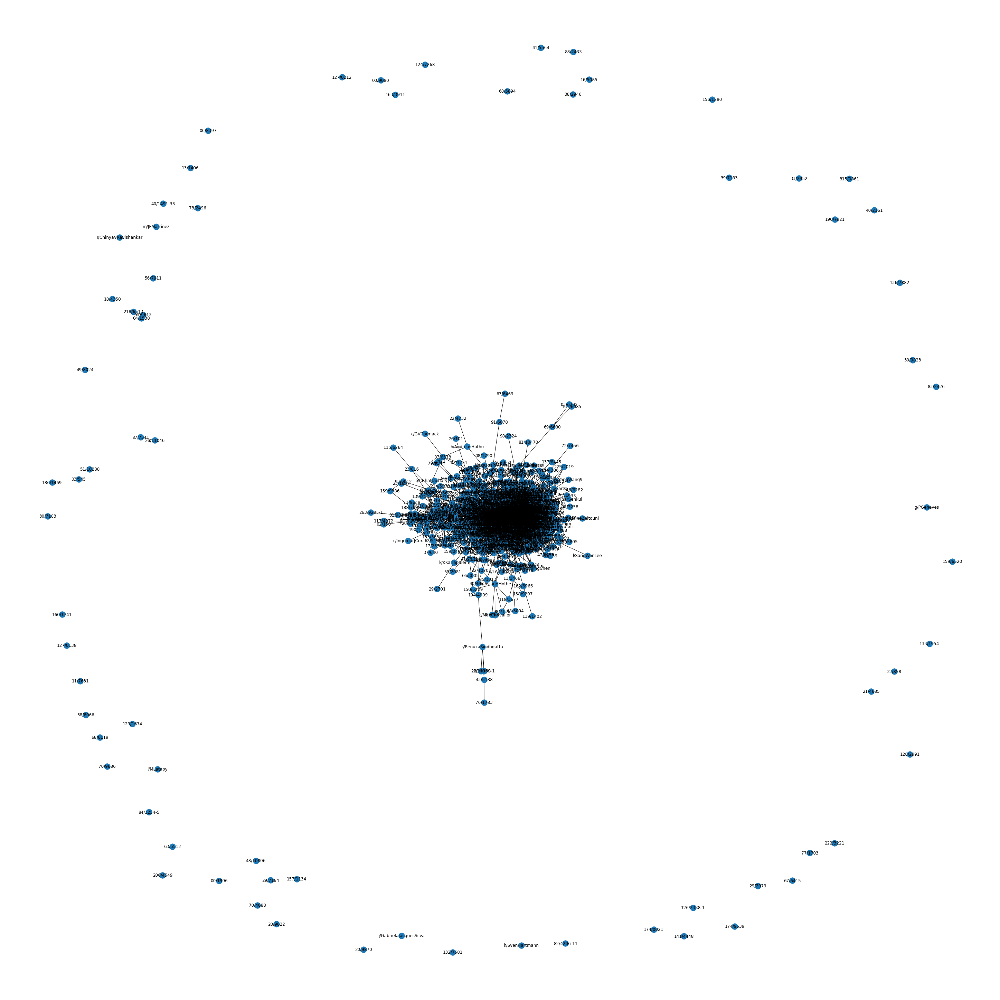

In [6]:
plt.figure(figsize=(40, 40))
nx.draw(G, with_labels=True)
plt.savefig('./Results/q1_graph_visualisation.png')

In [7]:
plt.figure(figsize=(100, 100))
ax = nv.circos(G)
plt.savefig('./Results/q1_circos.png')

# Degree Centrality and Distribution

In [8]:
# Compute the degree distribution
degrees = [len(list(G.neighbors(n))) for n in G.nodes()]

In [9]:
# Compute the degree centrality
deg_cent = nx.degree_centrality(G)

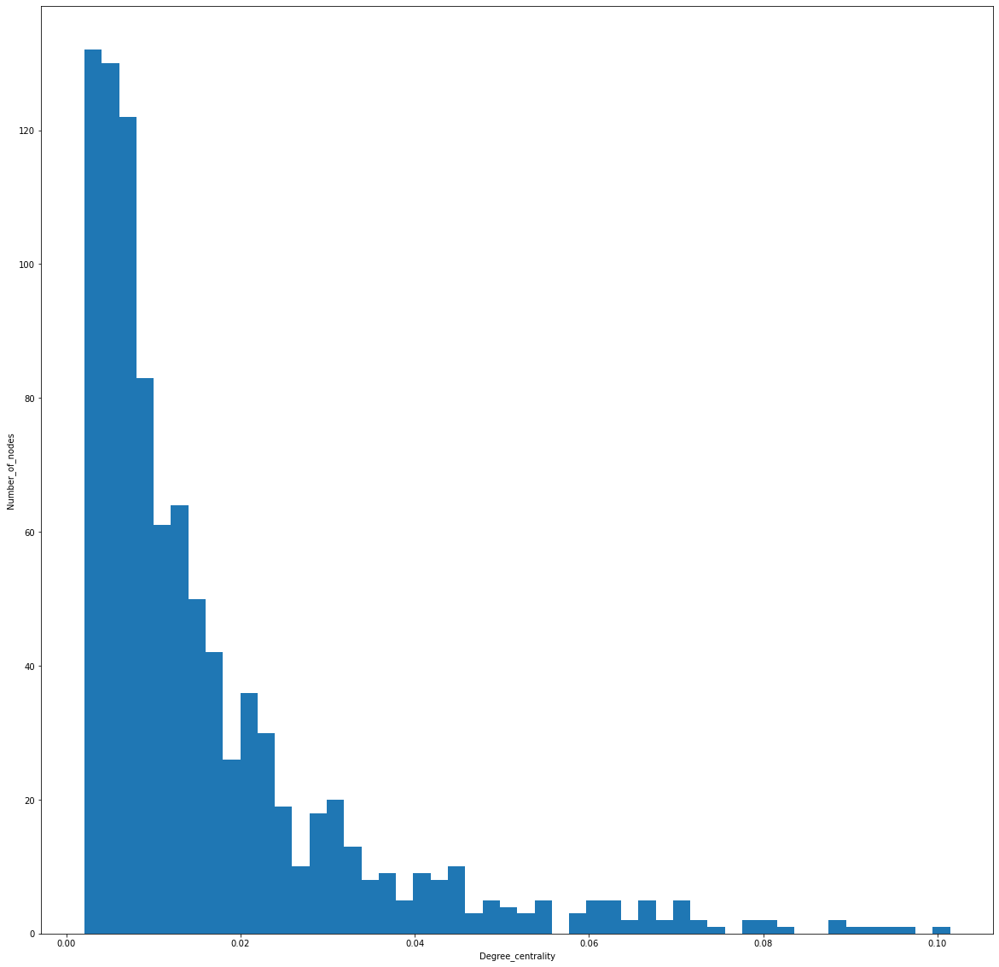

In [10]:
# Plot histogram of the degree centrality distribution of the graph
plt.figure(figsize=(20, 20))
plt.xlabel('Degree_centrality')
plt.ylabel('Number_of_nodes')
plt.hist(list(deg_cent.values()), bins=50)
plt.savefig('./Results/q1_deg_cent.png')

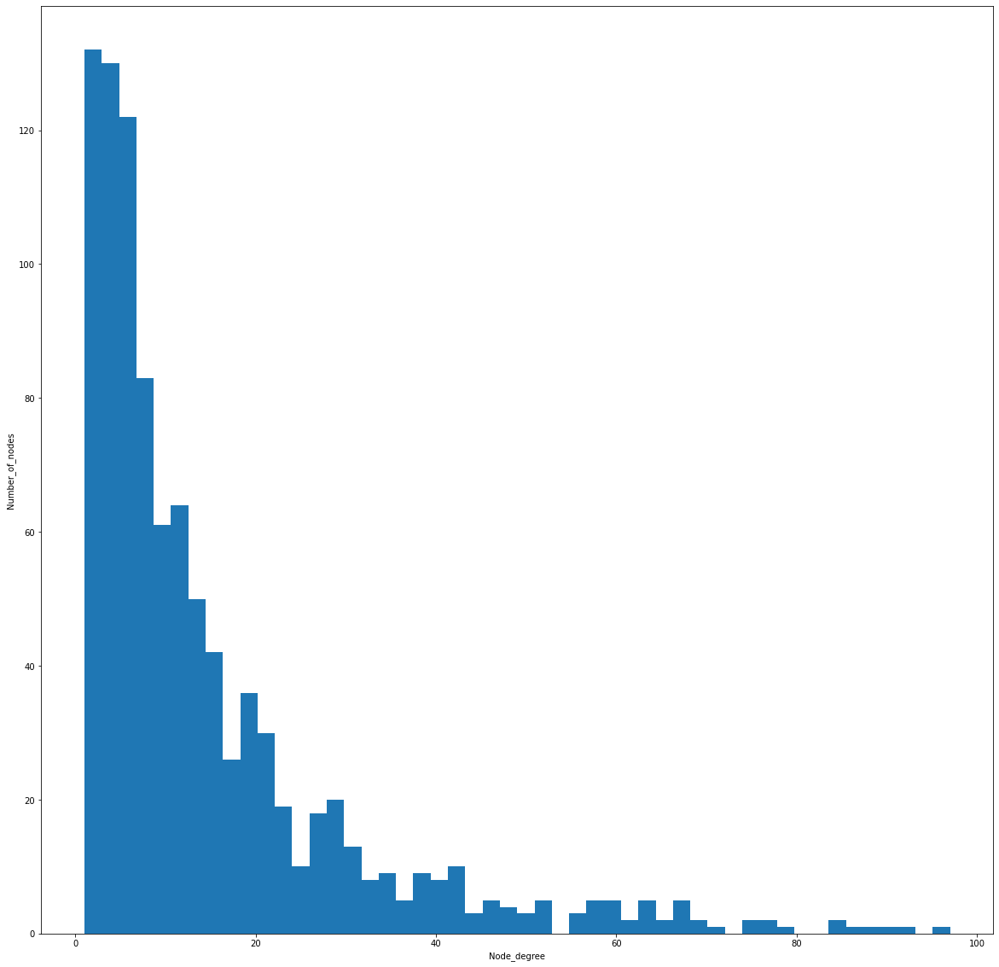

In [11]:
# Plot a histogram of the degree distribution of the graph
plt.figure(figsize=(20, 20))
plt.xlabel('Node_degree')
plt.ylabel('Number_of_nodes')
plt.hist(degrees, bins=50)
plt.savefig('./Results/q1_deg_dist.png')

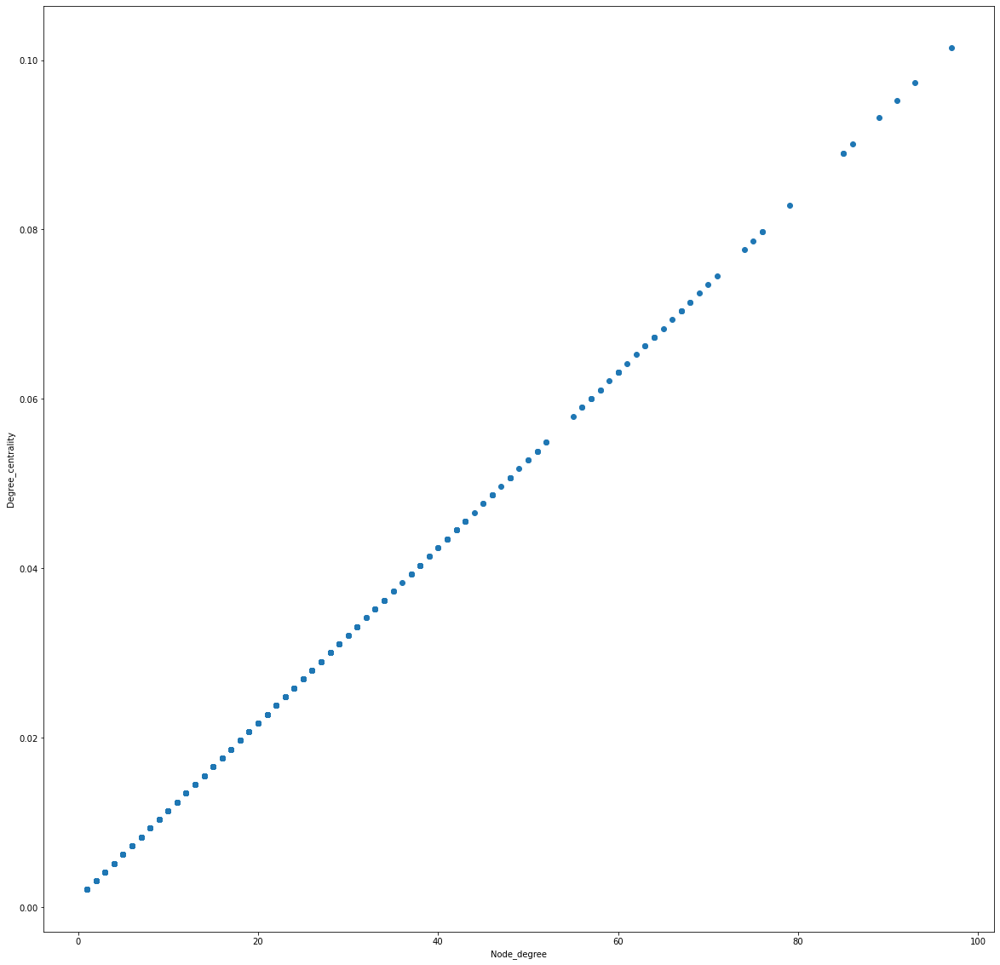

In [12]:
# Plot a scatter plot of the centrality distribution and the degree distribution
plt.figure(figsize=(20, 20))
plt.xlabel('Node_degree')
plt.ylabel('Degree_centrality')
plt.scatter(degrees, list(deg_cent.values()))
plt.savefig('./Results/q1_cent_and_deg_corr.png')

# Betweenness Centrality

In [13]:
bet_cent = nx.betweenness_centrality(G)

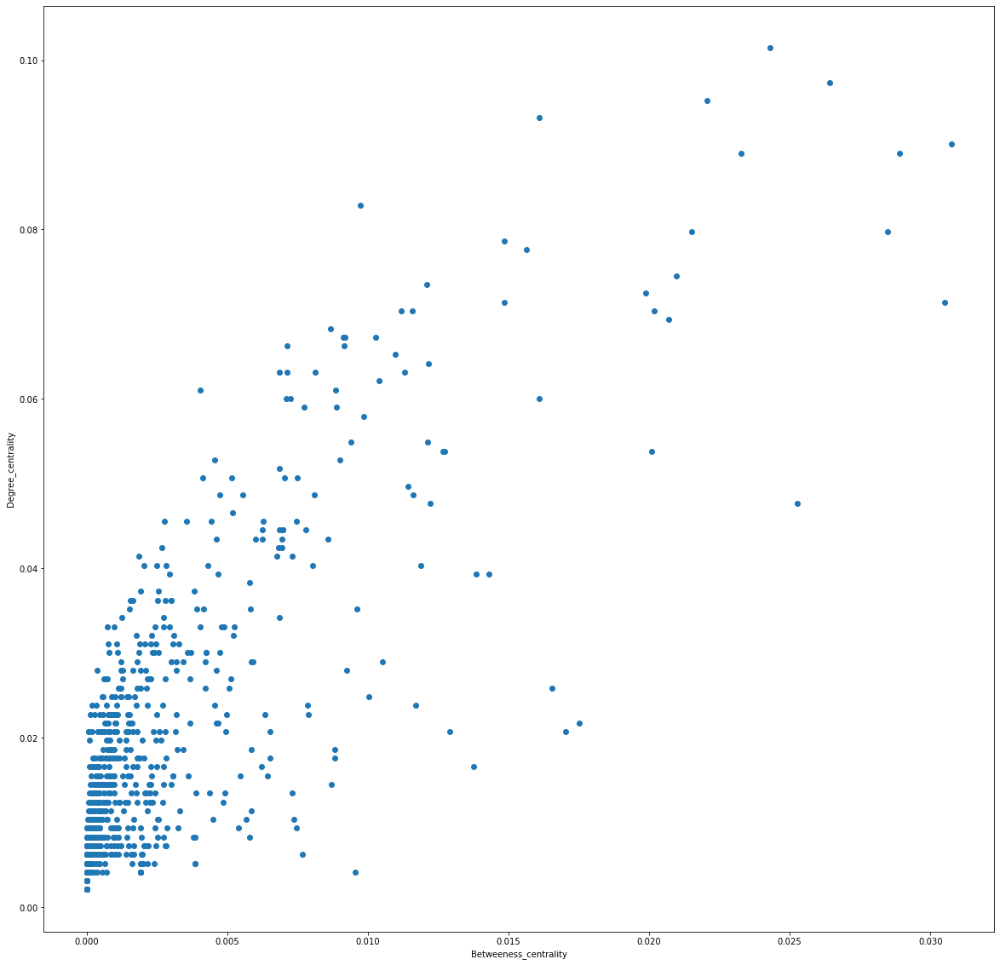

In [14]:
# Plot a scatter plot of the betweeness centrality and the degree centrality
plt.figure(figsize=(20, 20))
plt.scatter(list(bet_cent.values()), list(deg_cent.values()))
plt.xlabel('Betweeness_centrality')
plt.ylabel('Degree_centrality')
plt.savefig('./Results/q1_bet_and_deg_cent.png')

# Find the node with the highest Degree Centrality

In [15]:
def find_nodes_with_highest_deg_cent(graph):

    # Compute the degree centrality of G: deg_cent
    deg_cent = nx.degree_centrality(graph)

    # Compute the maximum degree centrality: max_dc
    max_dc = max(list(deg_cent.values()))

    nodes = set()

    # Iterate over the degree centrality dictionary
    for k, v in deg_cent.items():

        # Check if the current value has the maximum degree centrality
        if v == max_dc:

            # Add the current node to the set of nodes
            nodes.add(k)

    return nodes, max_dc

# Find the node(s) that has the highest degree centrality in T: top_dc
top_dc_node, top_dc_value = find_nodes_with_highest_deg_cent(G)

print(f'Author with highest degree centrality at {top_dc_value}: ', top_dc_node)

for node in top_dc_node:
    assert nx.degree_centrality(G)[node] == max(nx.degree_centrality(G).values())

Author with highest degree centrality at 0.10144927536231885:  {'o/BengChinOoi'}


# Find the node with the highest Betweeness Centrality

In [16]:
# Define find_node_with_highest_bet_cent()
def find_node_with_highest_bet_cent(graph):

    # Compute betweenness centrality: bet_cent
    bet_cent = nx.betweenness_centrality(graph)

    # Compute maximum betweenness centrality: max_bc
    max_bc = max(list(bet_cent.values()))

    nodes = set()

    # Iterate over the betweenness centrality dictionary
    for k, v in bet_cent.items():

        # Check if the current value has the maximum betweenness centrality
        if v == max_bc:

            # Add the current node to the set of nodes
            nodes.add(k)

    return nodes, max_bc

# Use that function to find the node(s) that has the highest betweenness centrality in the network: top_bc
top_bc_node, top_bc_value = find_node_with_highest_bet_cent(G)
print(f'Author with highest betweeness centrality at {top_bc_value}: ', top_bc_node)

for node in top_bc_node:
    assert nx.betweenness_centrality(G)[node] == max(nx.betweenness_centrality(G).values())

Author with highest betweeness centrality at 0.030742488465731663:  {'s/DiveshSrivastava'}


# Find the node with the highest Closeness Centrality


In [17]:
def find_node_with_highest_close_cent(graph):

    # Compute betweenness centrality: bet_cent
    close_cent = nx.closeness_centrality(graph)

    # Compute maximum betweenness centrality: max_bc
    max_cc = max(list(close_cent.values()))

    nodes = set()

    # Iterate over the betweenness centrality dictionary
    for k, v in close_cent.items():

        # Check if the current value has the maximum betweenness centrality
        if v == max_cc:

            # Add the current node to the set of nodes
            nodes.add(k)

    return nodes, max_cc

# Use that function to find the node(s) that has the highest betweenness centrality in the network: top_bc
top_cc_node, top_cc_value = find_node_with_highest_close_cent(G)
print(f'Author with highest closeness centrality at {top_cc_value}: ', top_cc_node)

Author with highest closeness centrality at 0.40596980354628515:  {'o/BengChinOoi'}


# Find the maximal clique (Giant component)

In [18]:
def maximal_cliques(graph):
    mcs = []
    giant_component_size = max([len(i) for i in nx.find_cliques(G)])
    
    for clique in nx.find_cliques(graph):
        if len(clique) == giant_component_size:
            mcs.append(clique)
            
    return giant_component_size, mcs
    

giant_size, giant_cliques = maximal_cliques(G)


print('Size of giant component: ', giant_size) 
print('Cliques of this size: ', giant_cliques)

Size of giant component:  25
Cliques of this size:  [['o/BengChinOoi', '16/4915', 'k/DonaldKossmann', 'c/SurajitChaudhuri', 'a/AnastassiaAilamaki', 'm/VMarkl', 'r/ChristopherRe', '26/6037', 'h/AlonYHalevy', 'b/PhilipABernstein', 'b/MagdalenaBalazinska', 's/DanSuciu', 'm/TovaMilo', 'f/MJFranklin', '58/4127', 's/MichaelStonebraker', 'd/AnHaiDoan', 'a/DJAbadi', 'i/StratosIdreos', 'b/PeterABoncz', '47/8816', '91/275', 'o/FatmaOzcan', 'f/JulianaFreire', 'd/XinLunaDong']]


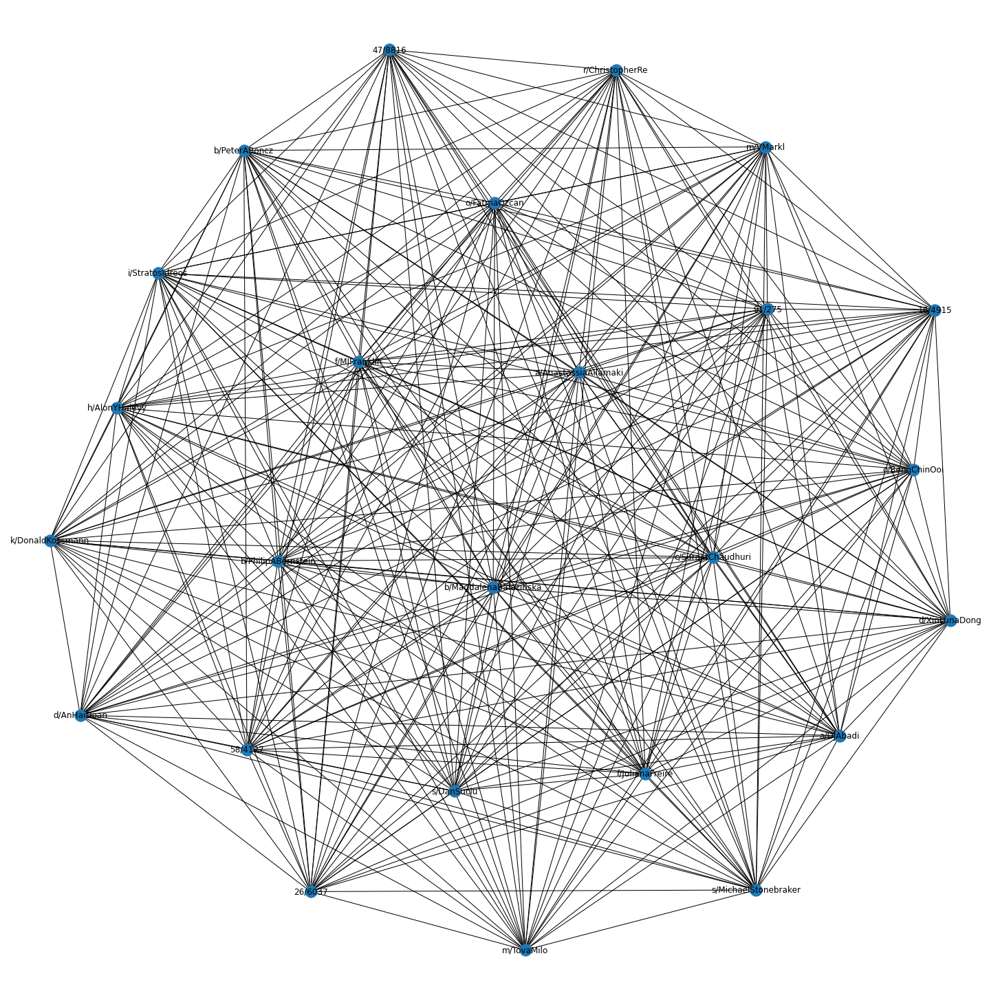

In [19]:
#Draw the subgraphs
i=0
for clique in giant_cliques:
    plt.figure(figsize=(20, 20))
    nx.draw(G.subgraph(giant_cliques[0]), with_labels=True)
    plt.savefig(f'./Results/q1_giant_component_{i}.png')
    i+=1

# Statistics

In [22]:
statistics = {
    
    'average_node_degree' : (2*len(G.edges()))/len(G.nodes()),
    'max_node_degree' : [list(G)[np.argmax(degrees)], max(degrees)],
    'degree_assortativity' : nx.degree_assortativity_coefficient(G),
    'average_clustering_coeff' : nx.average_clustering(G),
    'giant_component_size' : giant_size,
    'giant_component_clustering_coeff' : nx.average_clustering(G.subgraph(giant_cliques[0])),
    'graph_density' : nx.density(G),
    'node_highest_degree_centrality' : [top_dc_node, top_dc_value],
    'node_highest_betweeness_centrality' : [top_bc_node, top_bc_value],
    'node_highest_closeness_centrality' : [top_cc_node, top_cc_value],

}

with open('./Results/q1_statistics.txt', 'w') as f:
    print(statistics, file=f)

# Q2 analysis of collab network (Yearly granularity)

In [57]:
yearly_collab_network = pd.read_csv('./output/year_granularity_df.csv', index_col='Unnamed: 0')
yearly_collab_network.shape

(23, 976)

In [ ]:
for i in range(0, len(yearly_collab_network)):
    collab_network = pd.DataFrame(yearly_collab_network.iloc[i]).reset_index(names = ['author_pid']).rename({2024: 'coauthors_list'}, axis='columns')
    collab_network['coauthors_list'] = collab_network['coauthors_list'].apply(lambda x: ast.literal_eval(x))
    
    #run the bunch of analysis
    
    